In [2]:
#imports
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np  
import seaborn as sns

In [3]:
# Define the path to the file
flight_data = Path("../Data/CSV/cleaned_flight_data.csv")

# Read the data from the file
flight_data_df = pd.read_csv(flight_data)
flight_data_df.head()

,tbl,Year,quarter,departure_city_id,arrival_city_id,departure_city,arrival_city,departure_airport_id,arrival_airport_id,departure_airport,...,large_ms,fare_lg,carrier_low,lf_ms,fare_low,tbl1apk,departure_latitude,departure_longitude,arrival_latitude,arrival_longitude
0,Table 1a,2010,1,34614,33195,"Salt Lake City, UT","Tampa, FL (Metropolitan Area)",14869,15304,SLC,...,0.38,247.69,US Airways Group Inc.,0.20,166.99,201011486915304SLCTPA,40.758478,-111.888142,37.860600,-78.804199
1,Table 1a,1998,4,30189,31703,"Colorado Springs, CO","New York City, NY (Metropolitan Area)",11109,12197,COS,...,0.73,292.60,Northwest Airlines Inc.,0.24,248.27,199841110912197COSHPN,38.835224,-104.819798,40.123164,-75.333718
2,Table 1a,1998,4,30198,30852,"Pittsburgh, PA","Washington, DC (Metropolitan Area)",14122,10821,PIT,...,0.93,245.70,Continental Airlines Inc.,0.03,71.30,199841412210821PITBWI,40.442169,-79.994945,38.892062,-77.019912
3,Table 1a,2009,3,32211,32575,"Las Vegas, NV","Los Angeles, CA (Metropolitan Area)",12889,14908,LAS,...,0.58,118.28,US Airways Group Inc.,0.41,102.75,200931288914908LASSNA,36.169202,-115.140597,34.052238,-118.243344
4,Table 1a,1993,4,30255,30852,"Huntsville, AL","Washington, DC (Metropolitan Area)",12217,12264,HSV,...,0.48,275.50,United Air Lines Inc.,0.25,197.69,199341221712264HSVIAD,34.729538,-86.585283,38.892062,-77.019912


In [4]:
flight_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205189 entries, 0 to 205188
Data columns (total 25 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   tbl                   205189 non-null  object 
 1   Year                  205189 non-null  int64  
 2   quarter               205189 non-null  int64  
 3   departure_city_id     205189 non-null  int64  
 4   arrival_city_id       205189 non-null  int64  
 5   departure_city        205189 non-null  object 
 6   arrival_city          205189 non-null  object 
 7   departure_airport_id  205189 non-null  int64  
 8   arrival_airport_id    205189 non-null  int64  
 9   departure_airport     205189 non-null  object 
 10  arrival_airport       205189 non-null  object 
 11  nsmiles               205189 non-null  int64  
 12  passengers            205189 non-null  int64  
 13  fare                  205189 non-null  float64
 14  carrier_lg            205189 non-null  object 
 15  

In [5]:
flight_data_df.columns

Index(['tbl', 'Year', 'quarter', 'departure_city_id', 'arrival_city_id',
       'departure_city', 'arrival_city', 'departure_airport_id',
       'arrival_airport_id', 'departure_airport', 'arrival_airport', 'nsmiles',
       'passengers', 'fare', 'carrier_lg', 'large_ms', 'fare_lg',
       'carrier_low', 'lf_ms', 'fare_low', 'tbl1apk', 'departure_latitude',
       'departure_longitude', 'arrival_latitude', 'arrival_longitude'],
      dtype='object')

In [6]:
departure_airport = flight_data_df['departure_airport'].unique()
print(len(departure_airport))

178


In [7]:
arrival_airport =flight_data_df['arrival_airport'].unique()
print(len(arrival_airport))

163


In [8]:
departure_city = flight_data_df['departure_city'].unique()
print(len(departure_city))

136


In [9]:
arrival_city = flight_data_df['arrival_city'].unique()
print(len(arrival_city))

121


In [10]:
airlines = flight_data_df['carrier_low'].unique()
print(len(airlines))

69


In [11]:
airlines 


array(['US Airways Group Inc.', 'Northwest Airlines Inc.',
       'Continental Airlines Inc.', 'United Air Lines Inc.',
       'Frontier Airlines Inc.', 'American Airlines Inc.',
       'Southwest Airlines Co.', 'Delta Air Lines Inc.',
       'America West Airlines Inc.', 'AirTran Airways Corporation',
       'JetBlue Airways', 'Midwest Airlines Inc.', 'NJ',
       'Alaska Airlines Inc.', 'TW', 'BF', 'Spirit Air Lines', 'RU', 'DH',
       'Sun Country Airlines d/b/a MN Airlines', 'J7', 'JI',
       'ATA Airlines Inc.', 'RP', 'Allegiant Air', 'P9', 'U5',
       'Virgin America', 'WV', 'QQ', 'KW', 'AQ', 'ZA', 'KP', 'W9', 'UK',
       'HQ', 'W7', 'OE', 'N7', 'KN', 'FF', 'Atlantic Southeast Airlines',
       'TB', 'LC', 'Air Wisconsin Airlines', 'YY', 'Mesa Airlines', 'E9',
       'PN', '9N', 'PSA Airlines', 'U2', '5J', 'ZV', '9K', 'C8', 'RL',
       'T3', 'SkyWest Airlines', 'N5', 'KS', 'Hawaiian Airlines Inc.',
       '3M', 'OP', 'XJ', 'QX', 'SX', 'A7'], dtype=object)

### Calculate Correlation

In [12]:
# Compute the correlation matrix for the relevant columns
correlation_matrix = flight_data_df[['large_ms', 'fare_lg', 'lf_ms', 'fare_low']].corr()
print("Correlation Matrix:\n", correlation_matrix)

Correlation Matrix:
           large_ms   fare_lg     lf_ms  fare_low
large_ms  1.000000 -0.178920  0.521937 -0.091604
fare_lg  -0.178920  1.000000 -0.235000  0.839224
lf_ms     0.521937 -0.235000  1.000000  0.041644
fare_low -0.091604  0.839224  0.041644  1.000000


Correlation Matrix:
The correlation matrix shows relationships between market shares and fares:

- `large_ms` and `fare_lg`: Weak negative correlation of -0.18.
- `lf_ms` and `fare_lg`: Negative correlation of -0.24.
- `fare_lg` and `fare_low`: Strong positive correlation of 0.84.

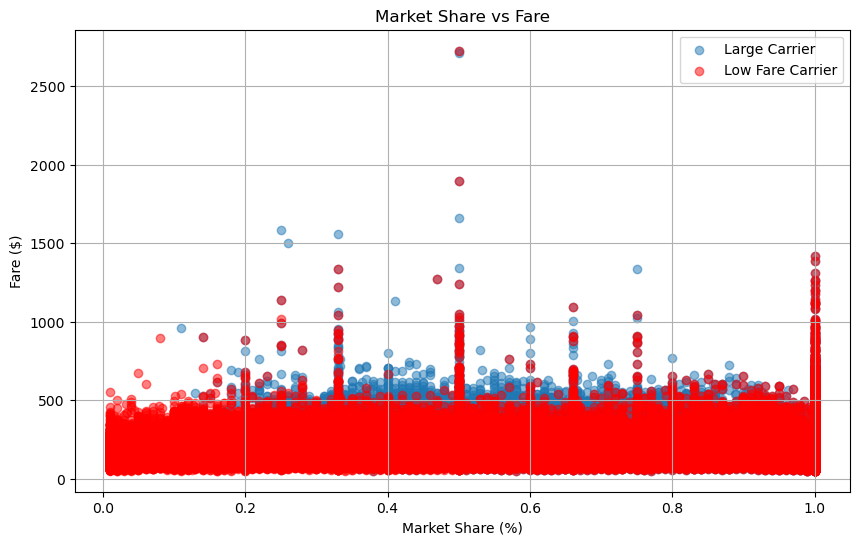

In [13]:
plt.figure(figsize=(10,6))
plt.scatter(flight_data_df['large_ms'], flight_data_df['fare_lg'], alpha=0.5, label="Large Carrier")
plt.scatter(flight_data_df['lf_ms'], flight_data_df['fare_low'], alpha=0.5, label="Low Fare Carrier", color='red')

plt.xlabel("Market Share (%)")
plt.ylabel("Fare ($)")
plt.title("Market Share vs Fare")
plt.legend()
plt.grid(True)
plt.savefig("../Data/Images/correlation_matrix.png")
plt.show()

In [14]:
# Fixing the code
highest_fare = flight_data_df[['fare_lg', 'fare_low']].max()
lowest_fare = flight_data_df[['fare_lg', 'fare_low']].min()
average_fare = flight_data_df[['fare_lg', 'fare_low']].mean()

print("Highest Fares:\n", highest_fare)
print("Lowest Fares:\n", lowest_fare)
print("Average Fares:\n", average_fare)

Highest Fares:
 fare_lg     2725.6
fare_low    2725.6
dtype: float64
Lowest Fares:
 fare_lg     50.0
fare_low    50.0
dtype: float64
Average Fares:
 fare_lg     216.240639
fare_low    188.975523
dtype: float64


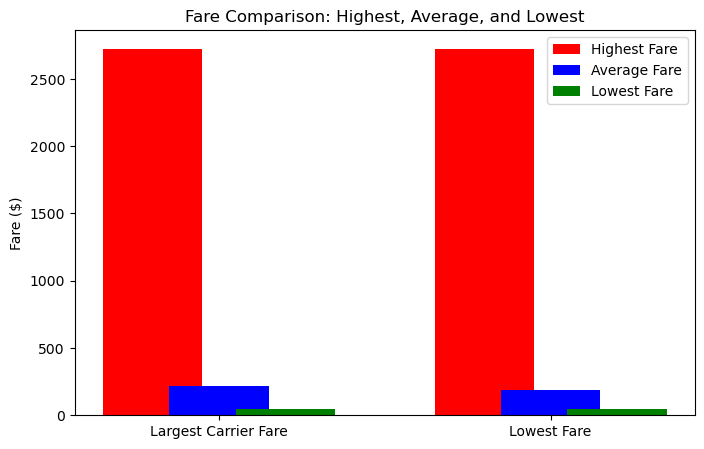

In [15]:
labels = ['Largest Carrier Fare', 'Lowest Fare']
highest = highest_fare.values
lowest = lowest_fare.values
average = average_fare.values

x = np.arange(len(labels))

plt.figure(figsize=(8,5))
plt.bar(x - 0.2, highest, 0.3, label="Highest Fare", color='red')
plt.bar(x, average, 0.3, label="Average Fare", color='blue')
plt.bar(x + 0.2, lowest, 0.3, label="Lowest Fare", color='green')

plt.xticks(x, labels)
plt.ylabel("Fare ($)")
plt.title("Fare Comparison: Highest, Average, and Lowest")
plt.legend()
plt.savefig("../Data/Images/HighLowAverage_Fare.png")
plt.show()

 Fare Distribution:
- The highest fares for both the largest and lowest carriers are the same (2725.6), which is unusual but could be a dataset characteristic.
- The lowest fares for both carriers are identical (50.0).
- Average fares differ slightly: the largest carrier charges an average of 216.24, while the lowest fare carrier charges 188.98.

In [16]:
# Correlation between fare and passengers (demand)
correlation_fare_passengers = flight_data_df[['fare', 'passengers']].corr()
print("\nCorrelation between fare and passengers:\n", correlation_fare_passengers)


Correlation between fare and passengers:
                fare  passengers
fare        1.00000    -0.19278
passengers -0.19278     1.00000


In [17]:
from scipy.stats import pearsonr

r_value, p_value = pearsonr(flight_data_df['fare'], flight_data_df['passengers'])
print(f"Pearson Correlation: {r_value:.5f}, P-value: {p_value:.5f}")


Pearson Correlation: -0.19278, P-value: 0.00000


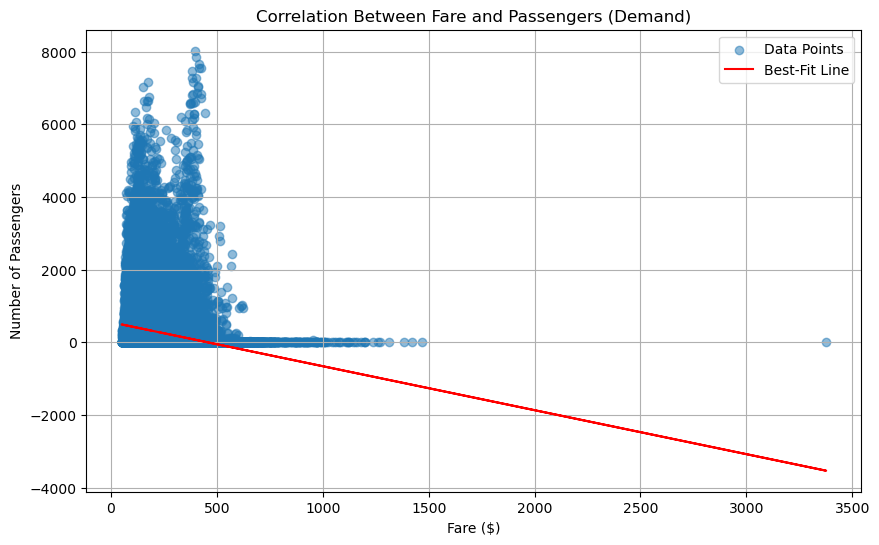

In [88]:
# Create the scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(flight_data_df['fare'], flight_data_df['passengers'], alpha=0.5, label="Data Points")

# Best-fit line calculation (linear regression)
m, b = np.polyfit(flight_data_df['fare'], flight_data_df['passengers'], 1)
plt.plot(flight_data_df['fare'], m * flight_data_df['fare'] + b, color='red', label="Best-Fit Line")

# Add labels and title
plt.xlabel("Fare ($)")
plt.ylabel("Number of Passengers")
plt.title("Correlation Between Fare and Passengers (Demand)")
plt.legend()
plt.grid(True)
plt.savefig("../Data/Images/correlation_fare_passengers.png")
# Show the plot
plt.show()

Correlation between Fare and Passengers:
- The correlation of -0.19278 suggests a weak negative relationship between fare and passengers. 
- As fare increases, the number of passengers tends to decrease slightly, but the correlation is not strong.

Final Summary:
- The correlation between fare and passengers is weak, indicating that price increases do not significantly decrease passenger numbers.
- Fare statistics reveal that while both largest and lowest carriers have identical highest and lowest fares, their average fares differ slightly.

### Calculate Flight Demand by Year and Quarter

In [89]:
year = flight_data_df["Year"].unique()
print(len(year))

27


In [90]:

#Group the data by Year and Quarter, summing the passengers
flight_demand_by_year_quarter = flight_data_df.groupby(['Year', 'quarter'])['passengers'].sum()

# Step 3: Find the year with the highest flight demand (highest sum of passengers)
best_demand_year = flight_demand_by_year_quarter.groupby('Year').sum().idxmax()
best_demand_year_sales = flight_demand_by_year_quarter.groupby('Year').sum().max()

# Step 4: Find the quarter with the highest flight demand within the best year
best_demand_quarter = flight_demand_by_year_quarter[best_demand_year].idxmax()
best_demand_quarter_sales = flight_demand_by_year_quarter[best_demand_year].max()

# Output the results
print(f"The year with the highest flight demand was {best_demand_year} with total passengers of {best_demand_year_sales}.")
print(f"The quarter with the highest flight demand in {best_demand_year} was Q{best_demand_quarter} with passengers {best_demand_quarter_sales}.")

The year with the highest flight demand was 2017 with total passengers of 3086637.
The quarter with the highest flight demand in 2017 was Q2 with passengers 813003.


Flight Demand Analysis:

- **Year with Highest Flight Demand**: 2017 with 3,086,637 passengers.
- **Quarter with Highest Flight Demand in 2017**: Q2 (April - June) with 813,003 passengers.

**Statistical Insight**: 
The highest flight demand in 2017 occurred in Q2, which could be due to increased travel during summer vacation months, business travel, or public holidays. These periods often see a surge in passengers.

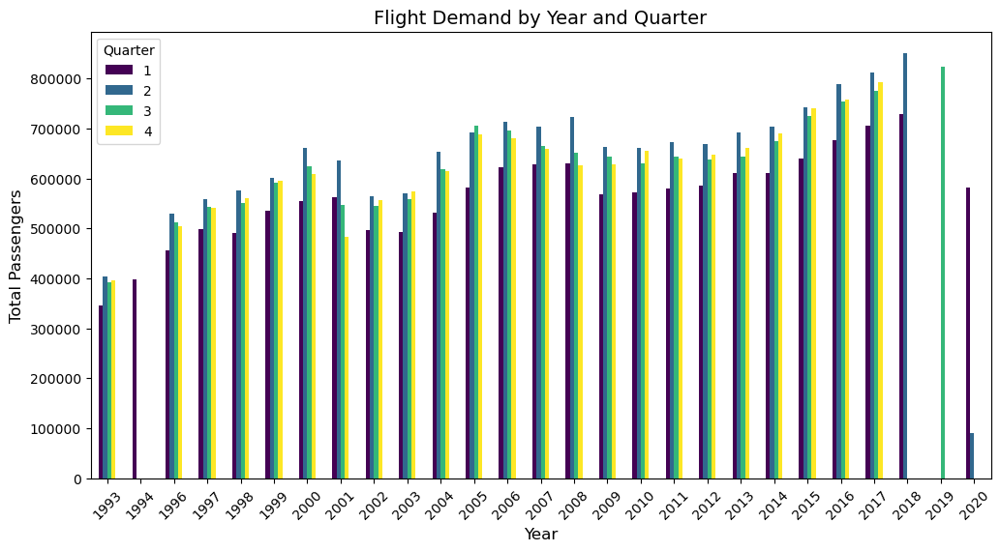

In [91]:
# Reset index for better plotting
flight_demand_by_year_quarter = flight_demand_by_year_quarter.reset_index()

# Pivot the data for a grouped bar chart
pivot_df = flight_demand_by_year_quarter.pivot(index='Year', columns='quarter', values='passengers')

# Plot the bar chart
pivot_df.plot(kind='bar', figsize=(12, 6), colormap='viridis')

# Customize the chart
plt.xlabel("Year", fontsize=12)
plt.ylabel("Total Passengers", fontsize=12)
plt.title("Flight Demand by Year and Quarter", fontsize=14)
plt.xticks(rotation=45)
plt.legend(title="Quarter")

plt.savefig("../Data/Images/flight_demand_by_year_quarter.png")
# Show the plot
plt.show()

### Calculate Revenue by Year and Quarter

In [92]:
# Calculate the total revenue per record (fare * passengers)
flight_data_df['revenue'] = flight_data_df['fare'] * flight_data_df['passengers']

# Group the data by Year and Quarter, summing the revenue
revenue_by_year_quarter = flight_data_df.groupby(['Year', 'quarter'])['revenue'].sum()

# Find the year with the highest revenue (best sales)
best_revenue_year = revenue_by_year_quarter.groupby('Year').sum().idxmax()
best_revenue_year_total = revenue_by_year_quarter.groupby('Year').sum().max()

# Find the quarter with the highest revenue within the best year
best_revenue_quarter = revenue_by_year_quarter[best_revenue_year].idxmax()
best_revenue_quarter_total = revenue_by_year_quarter[best_revenue_year].max()

# Output the results
print(f"The year with the best revenue was {best_revenue_year} with total revenue of {best_revenue_year_total}.")
print(f"The quarter with the best revenue in {best_revenue_year} was Q{best_revenue_quarter} with revenue {best_revenue_quarter_total}.")

The year with the best revenue was 2017 with total revenue of 632009964.4300001.
The quarter with the best revenue in 2017 was Q2 with revenue 171378275.99.


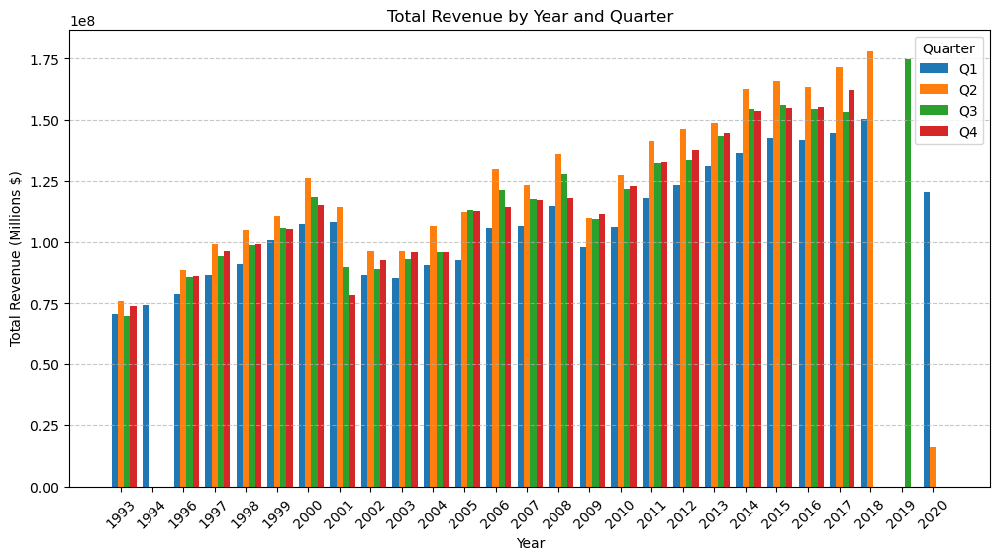

In [93]:
# Make a copy to avoid modifying the original DataFrame
revenue_plot_df = revenue_by_year_quarter.copy().reset_index()  # Reset index to make 'Year' and 'quarter' columns

# Extract unique years
years = sorted(revenue_plot_df['Year'].unique())
quarters = [1, 2, 3, 4]  # Fixed quarter values

# Prepare data for plotting
bar_width = 0.2  # Width of bars
x_indexes = np.arange(len(years))  # X-axis positions

# Create figure
plt.figure(figsize=(12, 6))

# Plot bars for each quarter
for i, q in enumerate(quarters):
    quarter_revenue = [
        revenue_plot_df.query("Year == @year and quarter == @q")['revenue'].values[0]
        if not revenue_plot_df.query("Year == @year and quarter == @q").empty else 0
        for year in years
    ]
    plt.bar(x_indexes + i * bar_width, quarter_revenue, width=bar_width, label=f'Q{q}')

# Formatting the plot
plt.xlabel("Year")
plt.ylabel("Total Revenue (Millions $)")
plt.title("Total Revenue by Year and Quarter")
plt.xticks(ticks=x_indexes + bar_width, labels=years, rotation=45)  # Rotate x-axis labels
plt.legend(title="Quarter")
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Show plot
plt.savefig("../Data/Images/revenue_plot_df.png")
plt.show()

Revenue Analysis:
- Multiplying fare × passengers gives total revenue, which helps measure how much airlines earned from ticket sales rather than just looking at the number of flights or passengers alone.
- **Year with the Best Revenue**: 2017 with a total revenue of \$632,009,964.43.
- **Quarter with the Best Revenue in 2017**: Q2 (April - June) with a revenue of \$171,378,275.99.

**Statistical Insight**:
Q2 of 2017 generated the highest revenue, likely due to increased flight demand during the summer travel season. This suggests that airlines capitalize on peak travel times, offering more flights and possibly higher fares during such quarters. The significant revenue in Q2 emphasizes the importance of seasonal demand on airline profitability.

Top Airlines by Revenue in 2017

In [94]:
# finding which airline did the best in 2017 
# filter for 2017 data
data_2017 = flight_data_df[flight_data_df['Year'] == 2017]

# Group by airline (carrier_lg) and sum the revenue
airline_revenue_2017 = data_2017.groupby('carrier_lg')['revenue'].sum().reset_index()

# Sort by revenue in descending order
airline_revenue_2017 = airline_revenue_2017.sort_values(by='revenue', ascending=False)

# Display the top airlines with highest revenue in 2017
print("Top Airlines by Revenue in 2017:")
print(airline_revenue_2017.head(11))  # Show top 10 airlines

Top Airlines by Revenue in 2017:
                                carrier_lg       revenue
7                   Southwest Airlines Co.  1.679892e+08
3                   American Airlines Inc.  1.505850e+08
10                   United Air Lines Inc.  1.281970e+08
4                     Delta Air Lines Inc.  1.134274e+08
6                          JetBlue Airways  3.773637e+07
1                     Alaska Airlines Inc.  2.291833e+07
11                          Virgin America  3.457048e+06
5                   Frontier Airlines Inc.  3.283271e+06
2                            Allegiant Air  2.373924e+06
8                         Spirit Air Lines  1.534200e+06
9   Sun Country Airlines d/b/a MN Airlines  5.082213e+05


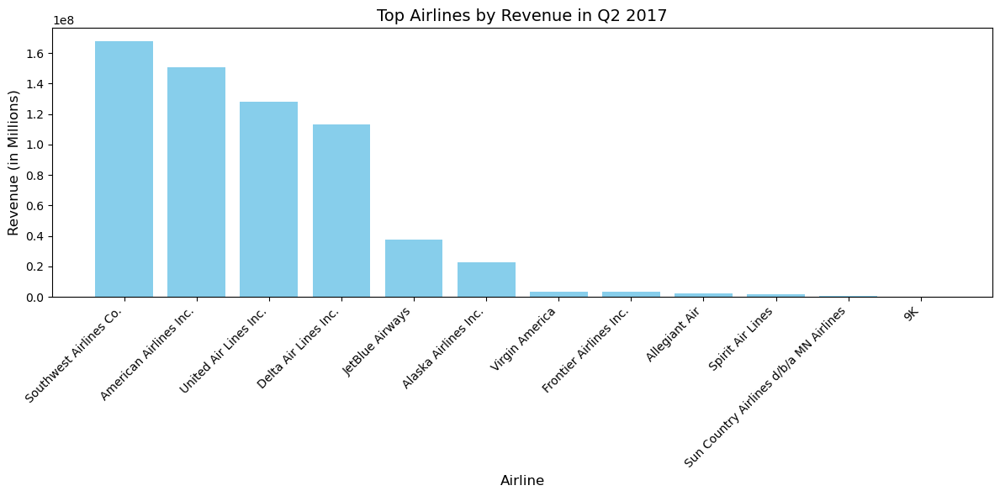

In [95]:
# Plot a bar chart
plt.figure(figsize=(12, 6))
plt.bar(airline_revenue_2017['carrier_lg'], airline_revenue_2017['revenue'], color='skyblue')

# Customize the plot
plt.xlabel("Airline", fontsize=12)
plt.ylabel("Revenue (in Millions)", fontsize=12)
plt.title("Top Airlines by Revenue in Q2 2017", fontsize=14)
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

# Adjust layout before saving
plt.tight_layout()

# Save the plot with adjusted spacing
plt.savefig("../Data/Images/airline_revenue_2017bar.png", bbox_inches='tight', dpi=300)

# Show the plot
plt.show()

1. Southwest Airlines Co. - 167.99 million dollars
2. American Airlines Inc. - 150.59 million dollars
3. United Air Lines Inc. - 128.20 million dollars
4. Delta Air Lines Inc. - 113.43 million dollars
5. JetBlue Airways - 37.74 million dollars
6. Alaska Airlines Inc. - 22.92 million dollars
7. Virgin America - 3.46 million dollars
8. Frontier Airlines Inc. - 3.28 million dollars
9. Allegiant Air - 2.37 million dollars
10. Spirit Air Lines - 1.53 million dollars
11. Sun Country Airlines d/b/a MN Airlines - 0.51 million dollars

We are using carrier_lg because it represents the largest carrier by passengers for each flight route. This allows us to analyze which airlines generated the most revenue in 2017

Top Airlines by Revenue in 2017:

- **Top Airline by Revenue**: Southwest Airlines Co. with \$167.99 million in revenue.
- **Other Notable Airlines**:
    - American Airlines Inc. - \$150.59 million
    - United Air Lines Inc. - \$128.20 million
    - Delta Air Lines Inc. - \$113.43 million
    - JetBlue Airways - \$37.74 million

**Statistical Insight**:
Southwest Airlines led the revenue charts in 2017, generating almost \$168 million. This is indicative of their dominant market position. On the other hand, airlines like Sun Country and Spirit generated the least revenue, pointing to the impact of market share, route offerings, and operational strategies on airline earnings.

Final Summary:

- **Flight Demand**: The year 2017 and Q2 showed the highest flight demand, suggesting a peak travel season in the middle of the year.
- **Revenue**: 2017 also stands out for the highest revenue, with Q2 leading, reflecting the strong correlation between increased travel and higher airline earnings.
- **Airline Performance**: Southwest Airlines emerged as the top performer, highlighting the role of a large market share and efficient operations in driving revenue.

# Correlation between Flight demand and Revenue


In [101]:
revenue_by_year_quarter.info()

<class 'pandas.core.series.Series'>
MultiIndex: 98 entries, (1993, 1) to (2020, 2)
Series name: revenue
Non-Null Count  Dtype  
--------------  -----  
98 non-null     float64
dtypes: float64(1)
memory usage: 2.3 KB


In [102]:
flight_demand_by_year_quarter.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98 entries, 0 to 97
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   Year        98 non-null     int64
 1   quarter     98 non-null     int64
 2   passengers  98 non-null     int64
dtypes: int64(3)
memory usage: 2.4 KB


In [103]:
# Convert revenue series to DataFrame
revenue_df = revenue_by_year_quarter.reset_index()  # Keeps MultiIndex as columns
revenue_df.columns = ['Year', 'quarter', 'revenue']  # Rename columns

# Convert demand series to DataFrame (already a DataFrame, just copying to be safe)
demand_df = flight_demand_by_year_quarter.copy()

# Merge the DataFrames on Year and Quarter
correlation_df = pd.merge(revenue_df, demand_df, on=['Year', 'quarter'])

# Compute correlation
correlation_value = correlation_df[['revenue', 'passengers']].corr().loc['revenue', 'passengers']

print("Correlation between revenue and passengers:", correlation_value)

Correlation between revenue and passengers: 0.9084048843871347


A correlation of 0.91 suggests a strong positive relationship between revenue and the number of passengers. This means that as the number of passengers increases, revenue also tends to increase significantly.

# mapping 

In [21]:
# Dependencies and Setup
import matplotlib.pyplot as plt
import hvplot.pandas
import pandas as pd
import requests
from pprint import pprint


In [22]:
# Define the boundaries for the regions based on the U.S. Census system

# West (Mountain and Pacific Divisions)
west_df = flight_data_df[
    (flight_data_df[
        'arrival_longitude'] >= -125) & (flight_data_df['arrival_longitude'] < -105)]

# Create map plots for each region using hvplot
map_west2 = west_df.hvplot.points('arrival_longitude', 'arrival_latitude',
                                 geo=True,
                                 tiles='OSM',
                                 size='passengers',
                                 color='carrier_lg',
                                 alpha=0.5,
                                 hover_cols=['arrival_city', 'arrival_airport'],
                                 frame_width=700,
                                 frame_height=500)
map_west2


:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [arrival_longitude,arrival_latitude]   (carrier_lg,passengers,arrival_city,arrival_airport)

In [23]:
# Midwest (East North Central and West North Central Divisions)
midwest_df = flight_data_df[
    (flight_data_df[
        'arrival_longitude'] >= -105) & (flight_data_df['arrival_longitude'] < -85)]

map_midwest2 = midwest_df.hvplot.points('arrival_longitude', 'arrival_latitude',
                                      geo=True,
                                      tiles='OSM',
                                      size='passengers',
                                      color='carrier_lg',
                                      alpha=0.5,
                                      hover_cols=['arrival_city', 'arrival_airport'],
                                      frame_width=700,
                                      frame_height=500)

map_midwest2

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [arrival_longitude,arrival_latitude]   (carrier_lg,passengers,arrival_city,arrival_airport)

In [24]:
# Northeast (New England and Middle Atlantic Divisions)
northeast_df = flight_data_df[
    (flight_data_df[
        'arrival_longitude'] >= -85) & (flight_data_df['arrival_longitude'] < -65)]

map_northeast2 = northeast_df.hvplot.points('arrival_longitude', 'arrival_latitude',
                                          geo=True,
                                          tiles='OSM',
                                          size='passengers',
                                          color='carrier_lg',
                                          alpha=0.5,
                                          hover_cols=['arrival_city', 'arrival_airport'],
                                          frame_width=700,
                                          frame_height=500)

map_northeast2

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [arrival_longitude,arrival_latitude]   (carrier_lg,passengers,arrival_city,arrival_airport)